In [ ]:
import cv2 #cv2 is used to help read images in colab
from google.colab.patches import cv2_imshow

In [ ]:
class Cartoonizer:
  def __init__(self):
    pass

  def render(self,img_path):
      img_rgb = cv2.imread(img_path)

      if img_rgb is None: #img_rgb: image red green blue
        print ('Image not found')
        return None

      orig_height, orig_width = img_rgb.shape[:2]

      numDownSamples = 2
      numBilateralFilters = 50 #how much we're filtering it

      img_color = img_rgb.copy()
      for _ in range(numDownSamples): #removing minor details in the pic
        img_color = cv2.pyrDown(img_color)

      for _ in range(numBilateralFilters):
        img_color = cv2.bilateralFilter(img_color, 9 , 9, 7) #1st num is, 2nd number is how much the colors are going to mix, the 3rd one is how much the pixels are going

      for _ in range(numDownSamples):
        img_color = cv2.pyrUp(img_color)

      img_color = cv2.resize(img_color, (orig_width, orig_height))

      img_gray = cv2.cvtColor(img_rgb , cv2.COLOR_RGB2GRAY) #helps preserve the edges better
      img_blur = cv2.medianBlur(img_gray, 3)

      img_edge = cv2.adaptiveThreshold(
          img_blur, 255,
          cv2.ADAPTIVE_THRESH_MEAN_C,
          cv2.THRESH_BINARY, 9, 2
          )

      img_edge = cv2.cvtColor(img_edge, cv2.COLOR_GRAY2RGB) #changing gray color back to color

      img_edge = cv2.resize(img_edge, (orig_width, orig_height))

      result = cv2.bitwise_and(img_color, img_edge)

      return result



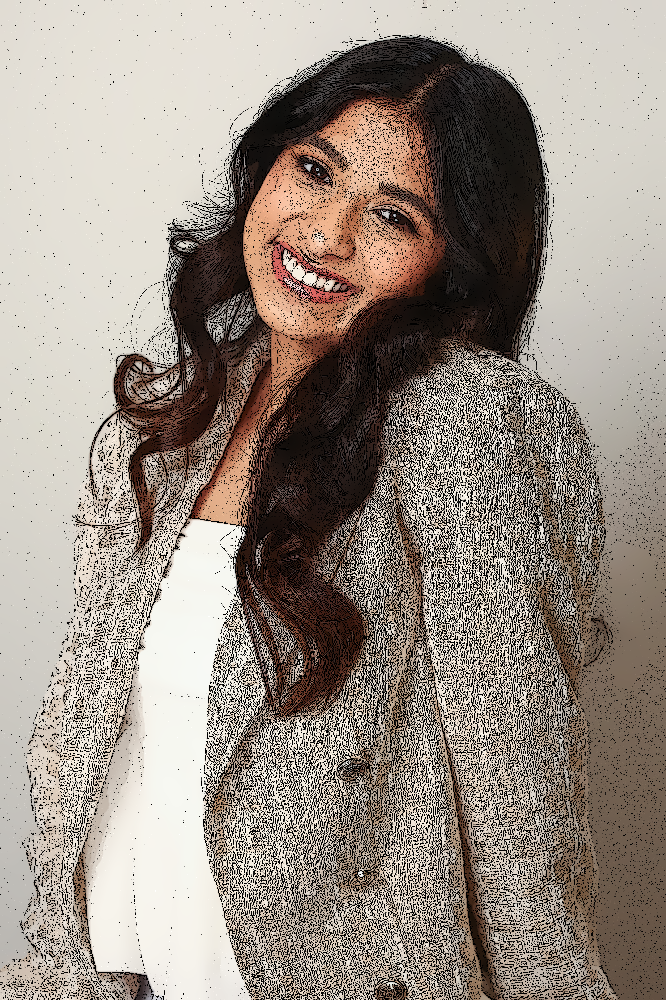

In [ ]:
tmp_canvas = Cartoonizer() #calling the function

file_name = "BEST.jpg"
res = tmp_canvas.render(file_name)

if res is not None:
  cv2.imwrite("BEST.jpg", res) #saves the cartoon image
  cv2_imshow(res) #shows the image in colab - this line is spcific to colab